In [5]:
# Import libraries 

import numpy as np    # Numeric and matrix computation
import pandas as pd   # Optional: good package for manipulating data 
import sklearn as sklearn  # Package with learning algorithms implemented

from sklearn.model_selection import train_test_split

In [6]:
train = pd.read_csv("Train.csv",index_col=0)
test = pd.read_csv("Test.csv",index_col=0)
print(train.shape)
train.head()

(68505, 71)


,age,weight,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses,...,DIS_D_19,DIS_D_20,DIS_D_27,DIS_D_28,race_AfricanAmerican,race_Asian,race_Caucasian,race_Hispanic,race_Other,readmitted
encounter_id,,,,,,,,,,,,,,,,,,,,,
53998338,-0.052190,0,2.898193,1.020554,0.975442,1.233164,-0.402535,-0.326184,-0.641890,0.814729,...,0,0,0,0,0,0,1,0,0,1
223073070,-1.938875,0,-0.467440,0.052003,-0.785799,-1.359868,-0.402535,-0.326184,-0.641890,-0.739071,...,0,0,0,0,0,0,1,0,0,1
249928416,1.834495,0,-1.140566,-0.814596,-0.785799,-1.359868,1.202434,-0.326184,-0.641890,0.814729,...,0,0,0,0,0,0,1,0,0,1
161192106,0.576705,0,-0.467440,0.255908,1.562522,-0.372046,3.324087,-0.326184,2.065845,0.814729,...,0,0,0,0,0,0,1,0,0,1
186275916,-0.052190,0,-0.467440,0.255908,-0.785799,-0.742479,-0.402535,-0.326184,-0.641890,-0.221138,...,0,0,0,0,1,0,0,0,0,1


In [7]:
X_train = train.drop("readmitted", axis=1)
y_train = train["readmitted"]
"""
X_test = test.drop("readmitted", axis=1)
y_test = test["readmitted"]"""
X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, random_state=42,test_size=0.3)

2018-12-20 00:08:54.150368
[[  110  2169]
 [  426 17847]]

Accuracy on test set: 0.8737349163098482

              precision    recall  f1-score   support

           0       0.21      0.05      0.08      2279
           1       0.89      0.98      0.93     18273

   micro avg       0.87      0.87      0.87     20552
   macro avg       0.55      0.51      0.51     20552
weighted avg       0.82      0.87      0.84     20552

Confidence interval:  (0.8691176465478127, 0.8782165848878406)
2018-12-20 00:09:04.044839


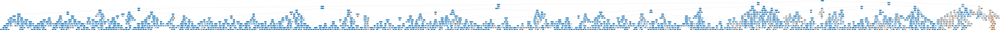

In [8]:
from sklearn import tree
from datetime import datetime
from sklearn.externals.six import StringIO  
import pydot
from IPython.display import Image  
from statsmodels.stats.proportion import proportion_confint
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
print(datetime.now())

clf = tree.DecisionTreeClassifier(criterion='entropy', min_samples_split=20, min_samples_leaf=2, max_depth=15)
pred = clf.fit(X_train, y_train).predict(X_test)
print(sklearn.metrics.confusion_matrix(y_test, pred))
print()
print("Accuracy on test set:", sklearn.metrics.accuracy_score(y_test, pred))
print()
print(sklearn.metrics.classification_report(y_test, pred))
epsilon = sklearn.metrics.accuracy_score(y_test, pred)
print("Confidence interval: ",proportion_confint(count=epsilon*X_test.shape[0], nobs=X_test.shape[0], alpha=0.05, method='binom_test'))

#scores = sklearn.model_selection.cross_val_score(clf, Xn, y, cv=10)
#print("Accuracy on 10 fold cross-validation:", scores)
#print(np.mean(scores))

## Print tree
dot_data = StringIO() 
tree.export_graphviz(clf, out_file=dot_data,    
                         filled=True, rounded=True,
                         feature_names=list(X_train.columns.values),  
                         special_characters=True)  
graph = pydot.graph_from_dot_data(dot_data.getvalue())  
print(datetime.now())
Image(graph[0].create_png()) 


/home/bernatgene/.local/lib/python3.5/site-packages/sklearn/feature_selection/univariate_selection.py:114: UserWarning: Features [28 63] are constant.
  UserWarning)
/home/bernatgene/.local/lib/python3.5/site-packages/sklearn/feature_selection/univariate_selection.py:115: RuntimeWarning: invalid value encountered in true_divide
  f = msb / msw


Index(['age', 'time_in_hospital', 'num_lab_procedures', 'num_procedures',
       'num_medications', 'number_outpatient', 'number_emergency',
       'number_inpatient', 'number_diagnoses', 'metformin', 'glimepiride',
       'insulin', 'change', 'diabetesMed', 'A1C_Abnormal', 'A1C_Normal',
       'MAXGLU_Abnormal', 'Diag_2', 'Diag_4', 'Diag_5', 'Diag_6', 'ADM_S_1',
       'ADM_S_4', 'ADM_S_7', 'ADM_T_1', 'ADM_T_3', 'DIS_D_1', 'DIS_D_2',
       'DIS_D_10', 'DIS_D_28'],
      dtype='object')
Decision Trees Final report
              precision    recall  f1-score   support

           0       0.14      0.62      0.23      2279
           1       0.92      0.52      0.66     18273

   micro avg       0.53      0.53      0.53     20552
   macro avg       0.53      0.57      0.45     20552
weighted avg       0.83      0.53      0.62     20552

Confusion matrix on test set:
 [[1410  869]
 [8739 9534]]
2018-12-20 00:09:25.379404


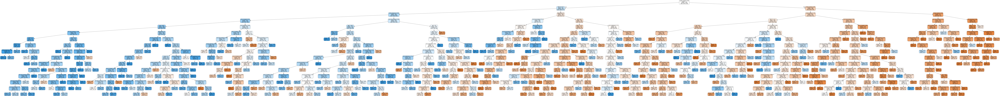

In [9]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
RANDOM_STATE=42

from imblearn.under_sampling import RandomUnderSampler
from imblearn import pipeline as pl

unique, counts = np.unique(y_train, return_counts=True)
dict(zip(unique, counts))

selector = SelectKBest(f_classif, k = 30)
selector.fit(X_train,y_train)
mask = selector.get_support()
new_features = X_train.columns[mask]
print(new_features)
X_train = X_train[new_features]
X_test = X_test[new_features]
clf = tree.DecisionTreeClassifier(criterion='entropy', min_samples_split=40, min_samples_leaf=5, max_depth=15)
pipeline = pl.make_pipeline(RandomUnderSampler(random_state=RANDOM_STATE), clf)
# Train the classifier with balancing
pipeline.fit(X_train, y_train)
# Test the classifier and get the prediction
y_pred_bal = pipeline.predict(X_test)
print("Decision Trees Final report")
print(classification_report(y_test, y_pred_bal))
print("Confusion matrix on test set:\n",confusion_matrix(y_test, y_pred_bal))

dot_data = StringIO() 
tree.export_graphviz(clf, out_file=dot_data,    
                         filled=True, rounded=True,
                         feature_names=list(X_train.columns.values),  
                         special_characters=True)  
graph = pydot.graph_from_dot_data(dot_data.getvalue())  
print(datetime.now())
Image(graph[0].create_png()) 





In [10]:
# REPEAT HERE GOOD STEP, with:
X_train = train.drop("readmitted", axis=1)
y_train = train["readmitted"]
X_test = test.drop("readmitted", axis=1)
y_test = test["readmitted"]


unique, counts = np.unique(y_train, return_counts=True)
dict(zip(unique, counts))

selector = SelectKBest(f_classif, k = 30)
selector.fit(X_train,y_train)
mask = selector.get_support()
new_features = X_train.columns[mask]
print(new_features)
X_train = X_train[new_features]
X_test = X_test[new_features]
clf = tree.DecisionTreeClassifier(criterion='entropy', min_samples_split=40, min_samples_leaf=5, max_depth=15)
pipeline = pl.make_pipeline(RandomUnderSampler(random_state=RANDOM_STATE), clf)
# Train the classifier with balancing
pipeline.fit(X_train, y_train)
# Test the classifier and get the prediction
y_pred_bal = pipeline.predict(X_test)
print("Decision Trees Final report")
print(classification_report(y_test, y_pred_bal))
print("Confusion matrix on test set:\n",confusion_matrix(y_test, y_pred_bal))

dot_data = StringIO() 
tree.export_graphviz(clf, out_file=dot_data,    
                         filled=True, rounded=True,
                         feature_names=list(X_train.columns.values),  
                         special_characters=True)  
graph = pydot.graph_from_dot_data(dot_data.getvalue())  
print(datetime.now())
Image(graph[0].create_png())


Index(['age', 'time_in_hospital', 'num_lab_procedures', 'num_procedures',
       'num_medications', 'number_outpatient', 'number_emergency',
       'number_inpatient', 'number_diagnoses', 'metformin', 'glimepiride',
       'insulin', 'change', 'diabetesMed', 'A1C_Abnormal', 'A1C_Normal',
       'MAXGLU_Abnormal', 'Diag_2', 'Diag_4', 'Diag_5', 'Diag_6', 'ADM_S_1',
       'ADM_S_4', 'ADM_S_7', 'ADM_T_1', 'ADM_T_3', 'DIS_D_1', 'DIS_D_2',
       'DIS_D_10', 'DIS_D_28'],
      dtype='object')
Decision Trees Final report
              precision    recall  f1-score   support

           0       0.16      0.54      0.24      3409
           1       0.91      0.61      0.73     25951

   micro avg       0.60      0.60      0.60     29360
   macro avg       0.53      0.58      0.49     29360
weighted avg       0.82      0.60      0.68     29360

Confusion matrix on test set:
 [[ 1849  1560]
 [10041 15910]]
2018-12-20 00:10:01.931337
